In [1]:
!pip install openmim

  Created wheel for openmim: filename=openmim-0.1.5-py2.py3-none-any.whl size=42503 sha256=c9e4ac19670bad0932bfff1aa30301ff6cb967b17af289649cec000cfeb19213
  Stored in directory: /root/.cache/pip/wheels/16/8b/e1/bdebbbc687aa50224a5ce46fe97a040a0c59f92b34bfc750b6
Successfully built openmim


In [2]:
!mim install mmdet

installing mmdet from https://github.com/open-mmlab/mmdetection.git.
Cloning into '/tmp/tmp0cuheeql/mmdetection'...
remote: Enumerating objects: 24084, done.
remote: Total 24084 (delta 0), reused 0 (delta 0), pack-reused 24084
Receiving objects: 100% (24084/24084), 37.33 MiB | 25.40 MiB/s, done.
Resolving deltas: 100% (16821/16821), done.
Note: checking out '3e2693151add9b5d6db99b944da020cba837266b'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

installing dependency: mmcv-full
installing mmcv-full from wheel.
Looking in links: https://download.openmmlab.com/mmcv/dist/cu111/torch1.10.0/index.html
     |████████████████████████████████

In [3]:
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu110/torch1.3.1/index.html

Looking in links: https://download.openmmlab.com/mmcv/dist/cu110/torch1.3.1/index.html


In [4]:
!mkdir checkpoints

In [5]:
!wget -c http://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth \
-O checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth

--2022-04-11 13:28:56--  http://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.254.186.233
Connecting to download.openmmlab.com (download.openmmlab.com)|47.254.186.233|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177867103 (170M) [application/octet-stream]
Saving to: ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’

checkpoints/mask_rc 100%[===================>] 169.63M  13.0MB/s    in 13s     

2022-04-11 13:29:10 (12.7 MB/s) - ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’ saved [177867103/177867103]



In [6]:
from google.colab import auth
from googleapiclient.discovery import build
from mmdet.apis import init_detector, inference_detector, show_result_pyplot

In [7]:
def download_data(file_id, file_name):
  import io
  from googleapiclient.http import MediaIoBaseDownload

  request = drive_service.files().get_media(fileId=file_id)
  downloaded = io.BytesIO()
  downloader = MediaIoBaseDownload(downloaded, request)
  done = False
  while done is False:
    _, done = downloader.next_chunk()
    
  downloaded.seek(0)
  with open(file_name, "wb") as f:
    f.write(downloaded.read())
  
auth.authenticate_user()
drive_service = build("drive", "v3")

mask_id = "1-i_GDIN41bfEtZbI6l022B4Db3IkdLxO"
mask_name = "mmdetection.zip"

image_id = "1e4NinwaT6LeelIk-Ef6KmqfEsCw71sXs"
image_name = "content.zip"

download_data(mask_id, mask_name)
!unzip mmdetection.zip

download_data(image_id, image_name)
!unzip content.zip

Archive:  mmdetection.zip
   creating: mmdetection/.circleci/
  inflating: mmdetection/.circleci/config.yml  
  inflating: mmdetection/.gitignore  
  inflating: mmdetection/.owners.yml  
  inflating: mmdetection/.pre-commit-config.yaml  
  inflating: mmdetection/.readthedocs.yml  
  inflating: mmdetection/CITATION.cff  
   creating: mmdetection/configs/
   creating: mmdetection/configs/_base_/
   creating: mmdetection/configs/_base_/datasets/
  inflating: mmdetection/configs/_base_/datasets/cityscapes_detection.py  
  inflating: mmdetection/configs/_base_/datasets/cityscapes_instance.py  
  inflating: mmdetection/configs/_base_/datasets/coco_detection.py  
  inflating: mmdetection/configs/_base_/datasets/coco_instance.py  
  inflating: mmdetection/configs/_base_/datasets/coco_instance_semantic.py  
  inflating: mmdetection/configs/_base_/datasets/coco_panoptic.py  
  inflating: mmdetection/configs/_base_/datasets/deepfashion.py  
  inflating: mmdetection/configs/_base_/datasets/lvis_v0

In [8]:
image_chickens: str = "content/chickens.jpg"
image_cows:     str = "content/cows.jpg"
image_horses:   str = "content/horses.jpg"
image_pigs:     str = "content/pigs.jpg"
image_sheeps:   str = "content/sheeps.jpg"
config:         str = "mmdetection/configs/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco.py"
checkpoint:     str = "checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth"

In [9]:
model = init_detector(config, checkpoint, device='cuda:0')

load checkpoint from local path: checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth


/usr/local/lib/python3.7/dist-packages/mmdet/datasets/utils.py:70: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


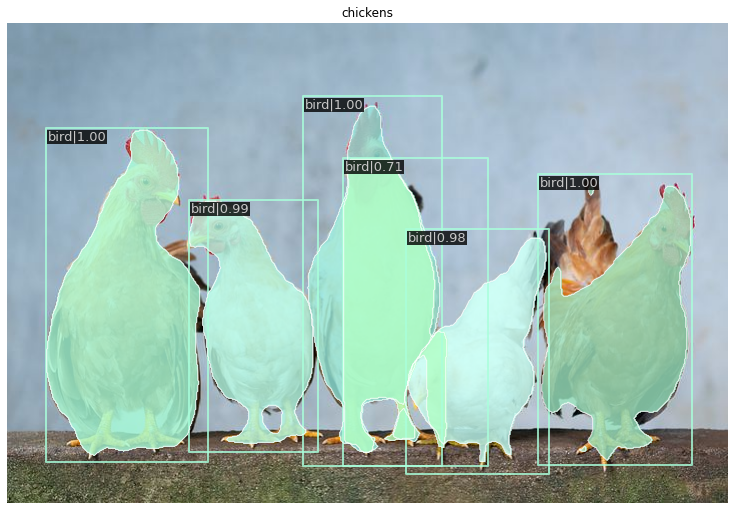

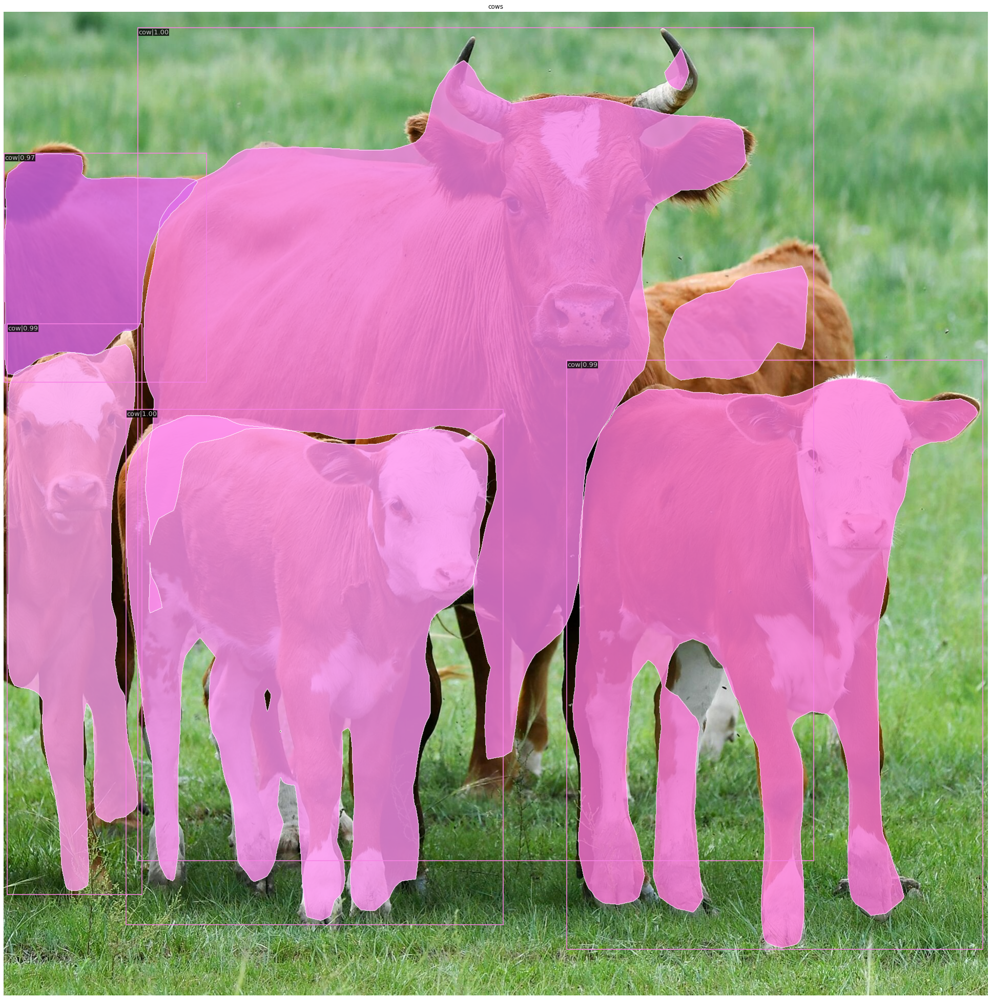

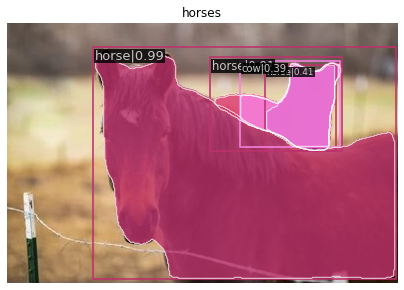

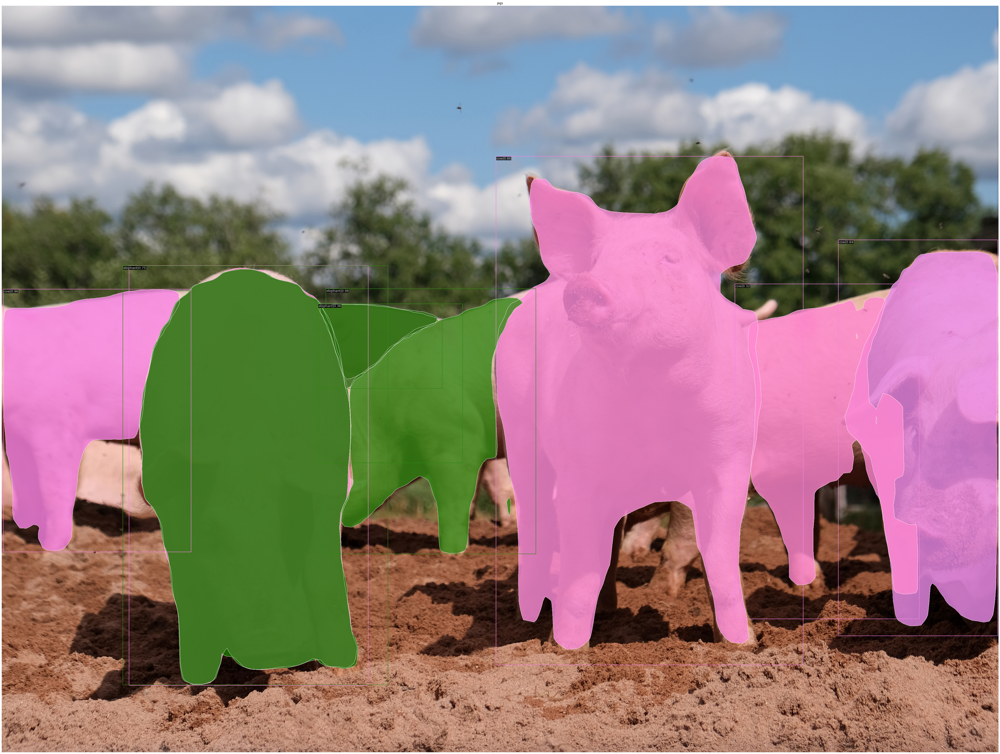

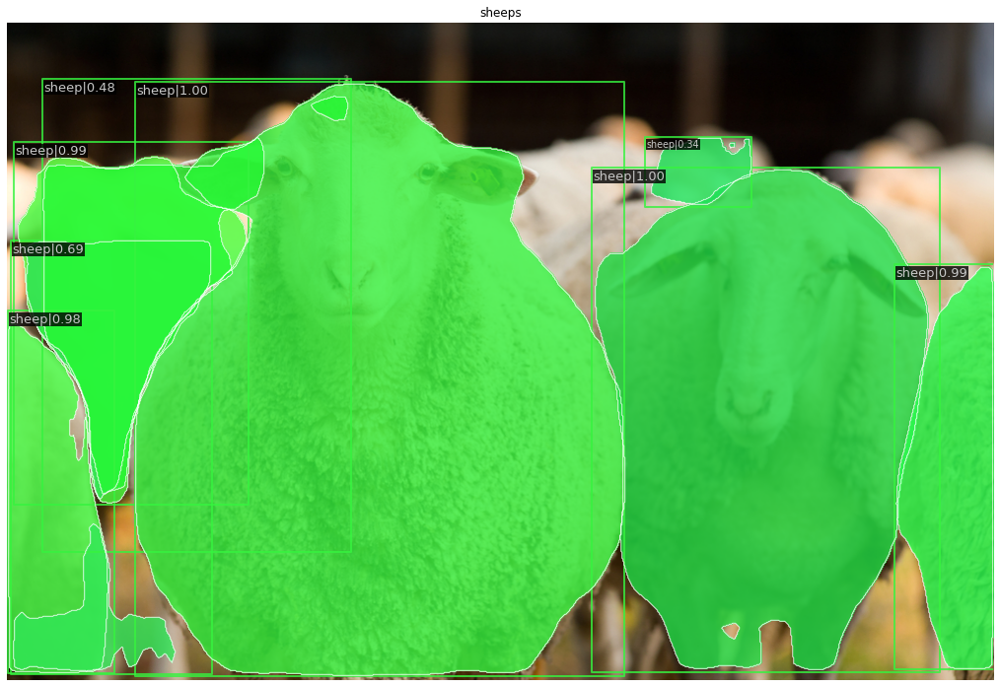

In [10]:
result_chickens = inference_detector(model, image_chickens)
result_cows     = inference_detector(model, image_cows)
result_horses   = inference_detector(model, image_horses)
result_pigs     = inference_detector(model, image_pigs)
result_sheeps   = inference_detector(model, image_sheeps)
show_result_pyplot(model, image_chickens, result_chickens, score_thr=0.3, title = "chickens")
show_result_pyplot(model, image_cows,     result_cows,     score_thr=0.3, title = "cows")
show_result_pyplot(model, image_horses,   result_horses,   score_thr=0.3, title = "horses")
show_result_pyplot(model, image_pigs,     result_pigs,     score_thr=0.3, title = "pigs")
show_result_pyplot(model, image_sheeps,   result_sheeps,   score_thr=0.3, title = "sheeps")